In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import datetime, gc, random
import json, numpy as np, pandas as pd, zipfile
import matplotlib.pyplot as plt
from itertools import cycle
from sklearn.cluster import MeanShift, estimate_bandwidth
# file
import zipfile

# Data preprocessing
import datetime
import re
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Visualization
from matplotlib import pyplot as plt
import folium
import seaborn as sns
sns.set_theme(style="ticks", color_codes=True)
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from colorama import Fore

# Random forest
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor

# parameter opimization
from sklearn.model_selection import GridSearchCV

# Validation
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/train.csv.zip
/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/metaData_taxistandsID_name_GPSlocation.csv.zip
/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/sampleSubmission.csv.zip
/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/evaluation_script.r
/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/test.csv.zip


CPU times: user 30.4 ms, sys: 2.31 ms, total: 32.7 ms
Wall time: 35 ms


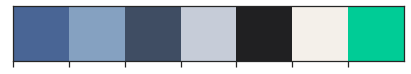

In [2]:
%%time
# Defining all our palette colours.
primary_blue = "#496595"
primary_blue2 = "#85a1c1"
primary_blue3 = "#3f4d63"
primary_grey = "#c6ccd8"
primary_black = "#202022"
primary_bgcolor = "#f4f0ea"

primary_green = px.colors.qualitative.Plotly[2]

plt.rcParams['axes.facecolor'] = primary_bgcolor

colors = [primary_blue, primary_blue2, primary_blue3, primary_grey, primary_black, primary_bgcolor, primary_green]
sns.palplot(sns.color_palette(colors))

# 1. Loading the Data

In [3]:
%%time
# Reading The Data

# sample
zip_file = zipfile.ZipFile("/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/sampleSubmission.csv.zip")
sample = pd.read_csv(zip_file.open('sampleSubmission.csv'))

# train
zip_file = zipfile.ZipFile("/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/train.csv.zip")
train = pd.read_csv(zip_file.open("train.csv"))

# test
zip_file = zipfile.ZipFile("/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/test.csv.zip")
test = pd.read_csv(zip_file.open("test.csv"))

# location_Data
zip_file = zipfile.ZipFile("/kaggle/input/pkdd-15-predict-taxi-service-trajectory-i/metaData_taxistandsID_name_GPSlocation.csv.zip")
location = pd.read_csv(zip_file.open("metaData_taxistandsID_name_GPSlocation.csv"))

CPU times: user 26.2 s, sys: 1.93 s, total: 28.1 s
Wall time: 35.5 s


Data Description

In [4]:
%%time
sample

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.96 µs


,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.146504,-8.611317
1,T2,41.146504,-8.611317
2,T3,41.146504,-8.611317
3,T4,41.146504,-8.611317
4,T5,41.146504,-8.611317
...,...,...,...
315,T323,41.146504,-8.611317
316,T324,41.146504,-8.611317
317,T325,41.146504,-8.611317
318,T326,41.146504,-8.611317


In [5]:
%%time
train

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 11 µs


,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE
0,1372636858620000589,C,NaN,NaN,20000589,1372636858,A,False,"[[-8.618643,41.141412],[-8.618499,41.141376],[..."
1,1372637303620000596,B,NaN,7.0,20000596,1372637303,A,False,"[[-8.639847,41.159826],[-8.640351,41.159871],[..."
2,1372636951620000320,C,NaN,NaN,20000320,1372636951,A,False,"[[-8.612964,41.140359],[-8.613378,41.14035],[-..."
3,1372636854620000520,C,NaN,NaN,20000520,1372636854,A,False,"[[-8.574678,41.151951],[-8.574705,41.151942],[..."
4,1372637091620000337,C,NaN,NaN,20000337,1372637091,A,False,"[[-8.645994,41.18049],[-8.645949,41.180517],[-..."
...,...,...,...,...,...,...,...,...,...
1710665,1404171463620000698,C,NaN,NaN,20000698,1404171463,A,False,"[[-8.612469,41.14602],[-8.612487,41.145993],[-..."
1710666,1404171367620000670,C,NaN,NaN,20000670,1404171367,A,False,"[[-8.610138,41.140845],[-8.610174,41.140935],[..."
1710667,1388745716620000264,C,NaN,NaN,20000264,1388745716,A,False,[]
1710668,1404141826620000248,B,NaN,12.0,20000248,1404141826,A,False,"[[-8.630712,41.154885],[-8.63073,41.154813],[-..."


In [6]:
%%time
test

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.2 µs


,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE
0,T1,B,NaN,15.0,20000542,1408039037,A,False,"[[-8.585676,41.148522],[-8.585712,41.148639],[..."
1,T2,B,NaN,57.0,20000108,1408038611,A,False,"[[-8.610876,41.14557],[-8.610858,41.145579],[-..."
2,T3,B,NaN,15.0,20000370,1408038568,A,False,"[[-8.585739,41.148558],[-8.58573,41.148828],[-..."
3,T4,B,NaN,53.0,20000492,1408039090,A,False,"[[-8.613963,41.141169],[-8.614125,41.141124],[..."
4,T5,B,NaN,18.0,20000621,1408039177,A,False,"[[-8.619903,41.148036],[-8.619894,41.148036]]"
...,...,...,...,...,...,...,...,...,...
315,T323,A,70885.0,NaN,20000430,1419171485,A,False,"[[-8.570196,41.159484],[-8.570187,41.158962],[..."
316,T324,B,NaN,53.0,20000020,1419170802,A,False,"[[-8.613873,41.141232],[-8.613882,41.141241],[..."
317,T325,C,NaN,NaN,20000207,1419172121,A,False,"[[-8.6481,41.152536],[-8.647461,41.15241],[-8...."
318,T326,A,76232.0,NaN,20000667,1419171980,A,False,"[[-8.571699,41.156073],[-8.570583,41.155929],[..."


In [7]:
%%time
location

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.68 µs


,ID,Descricao,Latitude,Longitude
0,1,Agra,41.1771457135,-8.609670
1,2,Alameda,41.15618964,-8.591064
2,3,Aldoar,41.1705249231,-8.665876
3,4,Alfândega,41.1437639911,-8.621803
4,5,Amial,41.1835097223,-8.612726
...,...,...,...,...
58,59,Tenente Valadim,41.1607030178,-8.641205
59,60,Trindade,41.1511237005,-8.609843
60,61,Vinte e Quatro de Agosto,41.1493101131,-8.600309
61,62,Viso,41.1778737602,-8.646558


# 2. Exploratory Data Analysis

In [8]:
%%time
# Time data preprocessing
train["TIMESTAMP"] = [float(time) for time in train["TIMESTAMP"]]
train["data_time"] = [datetime.datetime.fromtimestamp(time, datetime.timezone.utc) for time in train["TIMESTAMP"]]

CPU times: user 2.04 s, sys: 112 ms, total: 2.15 s
Wall time: 2.17 s


In [9]:
# Time data
train["data_time"].value_counts()

2014-03-27 19:31:22+00:00    5
2014-04-10 12:57:28+00:00    5
2014-03-27 18:49:12+00:00    5
2013-12-15 04:32:43+00:00    4
2014-05-10 04:54:38+00:00    4
                            ..
2014-01-24 19:44:48+00:00    1
2014-06-04 18:26:59+00:00    1
2013-11-12 11:03:19+00:00    1
2013-10-18 13:38:48+00:00    1
2013-07-13 05:50:26+00:00    1
Name: data_time, Length: 1655366, dtype: int64

In [10]:
%%time
# Time data preparation
train["year"] = train["data_time"].dt.year
train["month"] = train["data_time"].dt.month
train["day"] = train["data_time"].dt.day
train["hour"] = train["data_time"].dt.hour
train["min"] = train["data_time"].dt.minute
train["weekday"] = train["data_time"].dt.weekday

CPU times: user 922 ms, sys: 11.7 ms, total: 934 ms
Wall time: 935 ms


In [11]:
%%time
train.head()

CPU times: user 412 µs, sys: 0 ns, total: 412 µs
Wall time: 446 µs


,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,data_time,year,month,day,hour,min,weekday
0,1372636858620000589,C,NaN,NaN,20000589,1.372637e+09,A,False,"[[-8.618643,41.141412],[-8.618499,41.141376],[...",2013-07-01 00:00:58+00:00,2013,7,1,0,0,0
1,1372637303620000596,B,NaN,7.0,20000596,1.372637e+09,A,False,"[[-8.639847,41.159826],[-8.640351,41.159871],[...",2013-07-01 00:08:23+00:00,2013,7,1,0,8,0
2,1372636951620000320,C,NaN,NaN,20000320,1.372637e+09,A,False,"[[-8.612964,41.140359],[-8.613378,41.14035],[-...",2013-07-01 00:02:31+00:00,2013,7,1,0,2,0
3,1372636854620000520,C,NaN,NaN,20000520,1.372637e+09,A,False,"[[-8.574678,41.151951],[-8.574705,41.151942],[...",2013-07-01 00:00:54+00:00,2013,7,1,0,0,0
4,1372637091620000337,C,NaN,NaN,20000337,1.372637e+09,A,False,"[[-8.645994,41.18049],[-8.645949,41.180517],[-...",2013-07-01 00:04:51+00:00,2013,7,1,0,4,0


In [12]:
%%time
train.tail()

CPU times: user 334 µs, sys: 0 ns, total: 334 µs
Wall time: 341 µs


,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,data_time,year,month,day,hour,min,weekday
1710665,1404171463620000698,C,NaN,NaN,20000698,1.404171e+09,A,False,"[[-8.612469,41.14602],[-8.612487,41.145993],[-...",2014-06-30 23:37:43+00:00,2014,6,30,23,37,0
1710666,1404171367620000670,C,NaN,NaN,20000670,1.404171e+09,A,False,"[[-8.610138,41.140845],[-8.610174,41.140935],[...",2014-06-30 23:36:07+00:00,2014,6,30,23,36,0
1710667,1388745716620000264,C,NaN,NaN,20000264,1.388746e+09,A,False,[],2014-01-03 10:41:56+00:00,2014,1,3,10,41,4
1710668,1404141826620000248,B,NaN,12.0,20000248,1.404142e+09,A,False,"[[-8.630712,41.154885],[-8.63073,41.154813],[-...",2014-06-30 15:23:46+00:00,2014,6,30,15,23,0
1710669,1404157147620000079,B,NaN,34.0,20000079,1.404157e+09,A,False,"[[-8.615538,41.140629],[-8.615421,41.140746],[...",2014-06-30 19:39:07+00:00,2014,6,30,19,39,0


Time series visualization

CPU times: user 175 ms, sys: 122 ms, total: 297 ms
Wall time: 319 ms


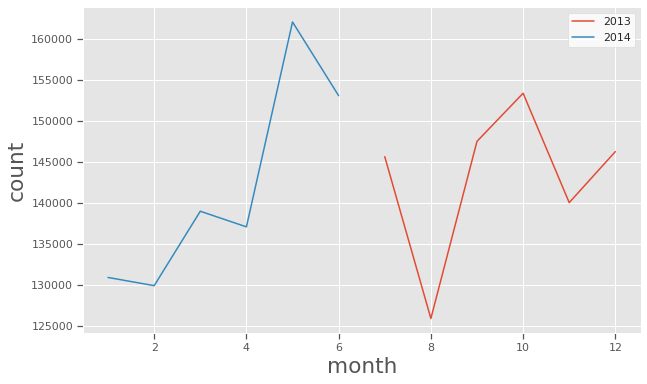

In [13]:
%%time
# Time series visualization
pivot = pd.pivot_table(train, index='month', columns="year", values="TRIP_ID", aggfunc="count").reset_index()

# Visualization, per month count
with plt.style.context("ggplot"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["month"], pivot[2013], label="2013")
    plt.plot(pivot["month"], pivot[2014], label="2014")
    plt.xlabel("month")
    plt.ylabel("count")
    plt.legend(facecolor="white")

CPU times: user 116 ms, sys: 30.1 ms, total: 146 ms
Wall time: 146 ms


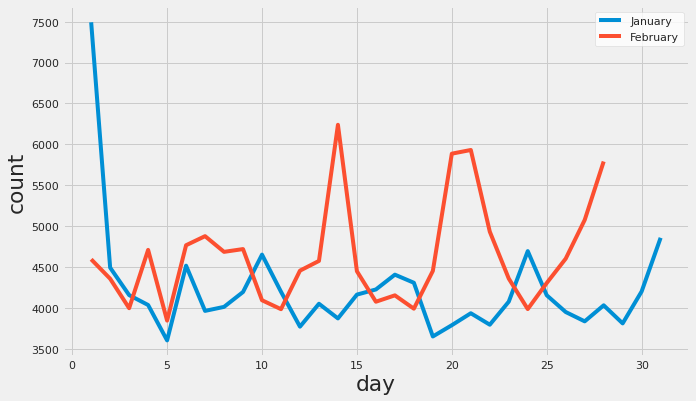

In [14]:
%%time
# Time series visualization
pivot = pd.pivot_table(train, index='day', columns="month", values="TRIP_ID", aggfunc="count").reset_index()
# Visualization, per day count
with plt.style.context("fivethirtyeight"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["day"], pivot[1], label="January")
    plt.plot(pivot["day"], pivot[2], label="February")
    plt.xlabel("day")
    plt.ylabel("count")
    plt.legend(facecolor="white")

CPU times: user 168 ms, sys: 13.3 ms, total: 182 ms
Wall time: 177 ms


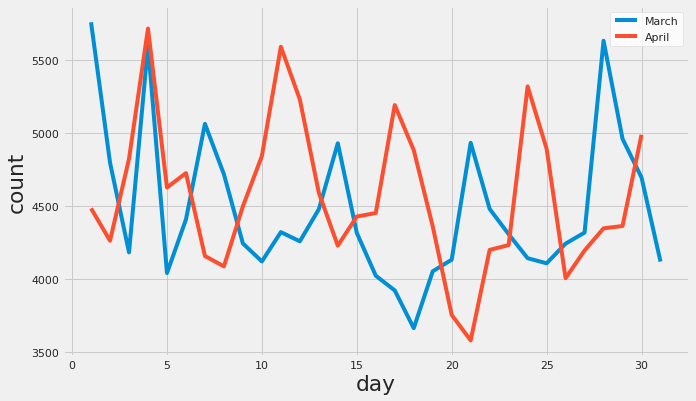

In [15]:
%%time
# Visualization, per day count
with plt.style.context("fivethirtyeight"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["day"], pivot[3], label="March")
    plt.plot(pivot["day"], pivot[4], label="April")
    plt.xlabel("day")
    plt.ylabel("count")
    plt.legend(facecolor="white")

CPU times: user 25.9 ms, sys: 3.3 ms, total: 29.2 ms
Wall time: 25.8 ms


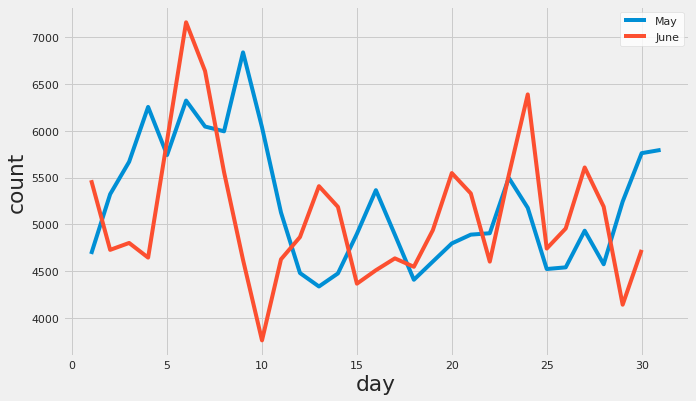

In [16]:
%%time
# Visualization, per day count
with plt.style.context("fivethirtyeight"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["day"], pivot[5], label="May")
    plt.plot(pivot["day"], pivot[6], label="June")
    plt.xlabel("day")
    plt.ylabel("count")
    plt.legend(facecolor="white")

CPU times: user 27.5 ms, sys: 3.17 ms, total: 30.7 ms
Wall time: 27.6 ms


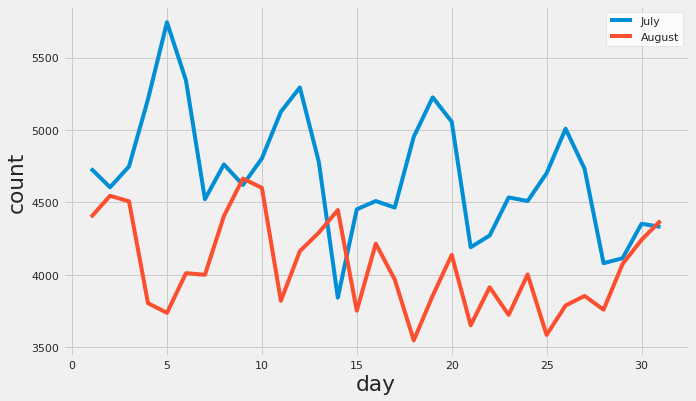

In [17]:
%%time
# Visualization, per day count
with plt.style.context("fivethirtyeight"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["day"], pivot[7], label="July")
    plt.plot(pivot["day"], pivot[8], label="August")
    plt.xlabel("day")
    plt.ylabel("count")
    plt.legend(facecolor="white")

CPU times: user 28 ms, sys: 2.11 ms, total: 30.1 ms
Wall time: 27.2 ms


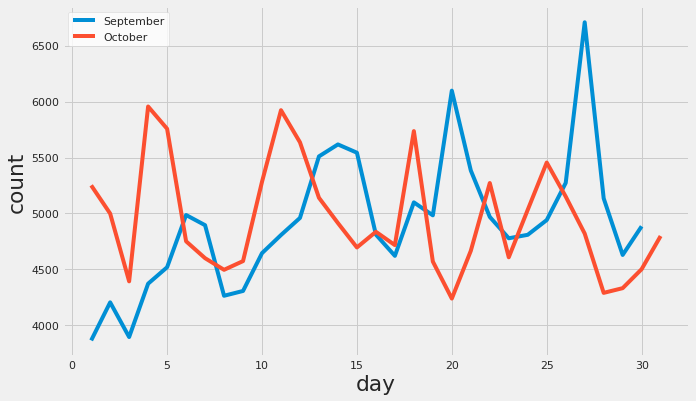

In [18]:
%%time
# Visualization, per day count
with plt.style.context("fivethirtyeight"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["day"], pivot[9], label="September")
    plt.plot(pivot["day"], pivot[10], label="October")
    plt.xlabel("day")
    plt.ylabel("count")
    plt.legend(facecolor="white")

CPU times: user 25.8 ms, sys: 4.19 ms, total: 30 ms
Wall time: 27 ms


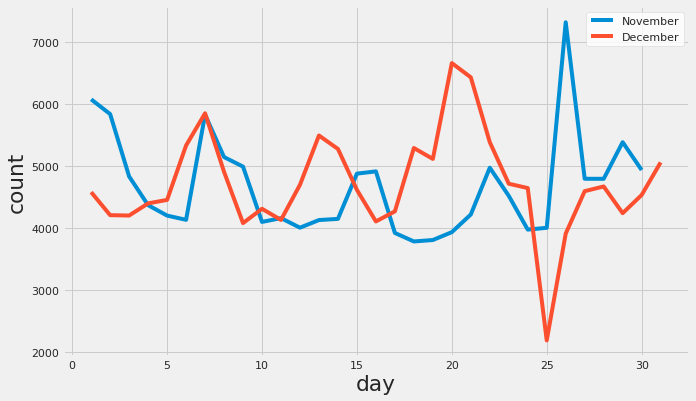

In [19]:
%%time
# Visualization, per day count
with plt.style.context("fivethirtyeight"):
    plt.figure(figsize=(10,6))
    plt.rcParams["font.size"] = 18
    plt.plot(pivot["day"], pivot[11], label="November")
    plt.plot(pivot["day"], pivot[12], label="December")
    plt.xlabel("day")
    plt.ylabel("count")
    plt.legend(facecolor="white")

Call type

In [20]:
%%time
### Call type
fig = px.histogram(train, x='CALL_TYPE', color='CALL_TYPE', color_discrete_sequence=[primary_blue, primary_grey],)
fig.update_layout(
    title_text='Call Type Distribution', # title of plot
    xaxis_title_text='Call Type', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    paper_bgcolor=primary_bgcolor,
    plot_bgcolor=primary_bgcolor,
)
fig.show()

CPU times: user 9.75 s, sys: 736 ms, total: 10.5 s
Wall time: 11.1 s


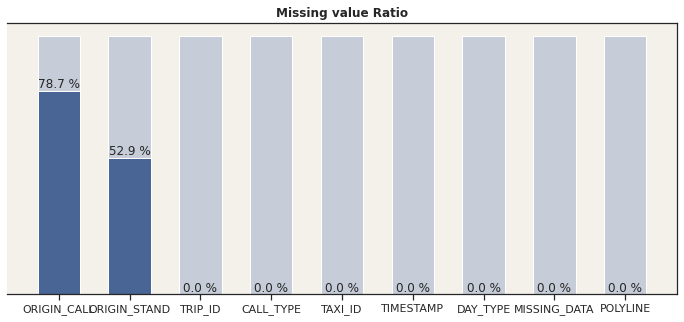

CPU times: user 548 ms, sys: 5.84 ms, total: 554 ms
Wall time: 559 ms


In [21]:
%%time
# Checking Missing Values
nan_data = (train.isna().sum().sort_values(ascending=False) / len(train) * 100)[:9]
fig, ax = plt.subplots(1,1,figsize=(12, 5))

ax.bar(nan_data.index, 100, color=primary_grey, width=0.6)

bar = ax.bar(
    nan_data.index, 
    nan_data, 
    color=primary_blue, 
    width=0.6
)
ax.bar_label(bar, fmt='%.01f %%')
ax.spines.left.set_visible(False)
ax.set_yticks([])
ax.set_title('Missing value Ratio', fontweight='bold')

plt.show()

Sampling 1st & last ride coordinate and last coordinate

# 3. Data Preprocessing

Training set preprocessing

In [22]:
%%time
# First longitude
lists_1st_lon = []
for i in range(0,len(train["POLYLINE"])):
    if train["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lon.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", train["POLYLINE"][i]).split(",")[0]
        lists_1st_lon.append(k)
        
train["lon_1st"] = lists_1st_lon

# First latitude
lists_1st_lat = []
for i in range(0,len(train["POLYLINE"])):
    if train["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", train["POLYLINE"][i]).split(",")[1]
        lists_1st_lat.append(k)
        
train["lat_1st"] = lists_1st_lat

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:8: FutureWarning:

Possible nested set at position 1



CPU times: user 3min 13s, sys: 1.19 s, total: 3min 14s
Wall time: 3min 14s


In [23]:
%%time
# Last longitude
lists_last_lon = []
for i in range(0,len(train["POLYLINE"])):
        if train["POLYLINE"][i] == '[]':
            k=0
            lists_last_lon.append(k)
        else:
            k = re.sub(r"[[|[|]|]|]]", "", train["POLYLINE"][i]).split(",")[-2]
            lists_last_lon.append(k)

train["lon_last"] = lists_last_lon

# Last latitude
lists_last_lat = []
for i in range(0,len(train["POLYLINE"])):
    if train["POLYLINE"][i] == '[]':
        k=0
        lists_last_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", train["POLYLINE"][i]).split(",")[-1]
        lists_last_lat.append(k)
        
train["lat_last"] = lists_last_lat

CPU times: user 3min 11s, sys: 261 ms, total: 3min 12s
Wall time: 3min 12s


In [24]:
%%time
# Delete lon & lat have "0".
train = train.query("lon_last != 0")

CPU times: user 933 ms, sys: 284 ms, total: 1.22 s
Wall time: 1.22 s


In [25]:
%%time
train["lon_1st"] = [float(k) for k in train["lon_1st"]]
train["lat_1st"] = [float(k) for k in train["lat_1st"]]
train["lon_last"] = [float(k) for k in train["lon_last"]]
train["lat_last"] = [float(k) for k in train["lat_last"]]

CPU times: user 3.05 s, sys: 368 ms, total: 3.42 s
Wall time: 3.42 s


In [26]:
%%time
# Visualization, sampling 5000 datas.
mapping_1st = pd.DataFrame({
    "date":train.head(5000)["data_time"].values,
    "lat":train.head(5000)["lat_1st"].values,
    "lon":train.head(5000)["lon_1st"].values
})

mapping_last = pd.DataFrame({
    "date":train.head(5000)["data_time"].values,
    "lat":train.head(5000)["lat_last"].values,
    "lon":train.head(5000)["lon_last"].values
})

por_map = folium.Map(location=[41.141412,-8.590324], tiles='Stamen Terrain', zoom_start=11)

for i, r in mapping_1st.iterrows():
    folium.CircleMarker(location=[r["lat"],r["lon"]], radius=0.5, color="red").add_to(por_map)

for i, r in mapping_last.iterrows():
    folium.CircleMarker(location=[r["lat"],r["lon"]], radius=0.5, color="blue").add_to(por_map)    
    
por_map


CPU times: user 1.34 s, sys: 44.9 ms, total: 1.38 s
Wall time: 1.39 s


Test set preprocessing

In [27]:
%%time
# First longitude
lists_1st_lon = []
for i in range(0,len(test["POLYLINE"])):
    if test["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lon.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", test["POLYLINE"][i]).split(",")[0]
        lists_1st_lon.append(k)
        
test["lon_1st"] = lists_1st_lon

# First latitude
lists_1st_lat = []
for i in range(0,len(test["POLYLINE"])):
    if test["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", test["POLYLINE"][i]).split(",")[1]
        lists_1st_lat.append(k)
        
test["lat_1st"] = lists_1st_lat

CPU times: user 60 ms, sys: 0 ns, total: 60 ms
Wall time: 60 ms


In [28]:
%%time
# Last longitude
lists_last_lon = []
for i in range(0,len(test["POLYLINE"])):
        if test["POLYLINE"][i] == '[]':
            k=0
            lists_last_lon.append(k)
        else:
            k = re.sub(r"[[|[|]|]|]]", "", test["POLYLINE"][i]).split(",")[-2]
            lists_last_lon.append(k)

test["lon_last"] = lists_last_lon

# Last latitude
lists_last_lat = []
for i in range(0,len(test["POLYLINE"])):
    if test["POLYLINE"][i] == '[]':
        k=0
        lists_last_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", test["POLYLINE"][i]).split(",")[-1]
        lists_last_lat.append(k)
        
test["lat_last"] = lists_last_lat

CPU times: user 62.4 ms, sys: 3.01 ms, total: 65.4 ms
Wall time: 64.3 ms


In [29]:
%%time
# changin type str ⇒ float
test["lon_1st"] = [float(k) for k in test["lon_1st"]]
test["lat_1st"] = [float(k) for k in test["lat_1st"]]
test["lon_last"] = [float(k) for k in test["lon_last"]]
test["lat_last"] = [float(k) for k in test["lat_last"]]

CPU times: user 2.32 ms, sys: 4 µs, total: 2.32 ms
Wall time: 2 ms


Distribution of travel distance and direction

delta_lon = lon_last - lon_1st
delta_lat = lat_last - kat_last

In [30]:
%%time

# Create delta parameter
train["delta_lon"] = train["lon_last"] - train["lon_1st"]
train["delta_lat"] = train["lat_last"] - train["lat_1st"]

test["delta_lon"] = test["lon_last"] - test["lon_1st"]
test["delta_lat"] = test["lat_last"] - test["lat_1st"]

CPU times: user 21 ms, sys: 969 µs, total: 22 ms
Wall time: 19 ms


CPU times: user 97.9 ms, sys: 2 ms, total: 99.9 ms
Wall time: 99.7 ms


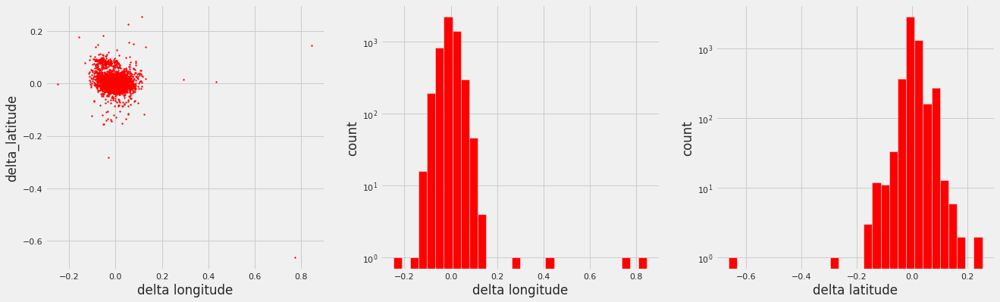

In [31]:
%%time
# sampling : 5,000 point
sample = train.head(5000)

with plt.style.context("fivethirtyeight"):
    fig, ax = plt.subplots(1,3,figsize=(20, 6))
    
    # plot
    ax[0].scatter(sample["delta_lon"], sample["delta_lat"], s=3, c="red")
    ax[0].set_xlabel("delta longitude")
    ax[0].set_ylabel("delta_latitude")
    
    # delta longitude distribution
    ax[1].hist(sample["delta_lon"], bins=30, color="red")
    ax[1].set_xlabel("delta longitude")
    ax[1].set_ylabel("count")
    ax[1].set_yscale("log")
    
    # delta latitude distribution
    ax[2].hist(sample["delta_lat"], bins=30, color="red")
    ax[2].set_xlabel("delta latitude")
    ax[2].set_ylabel("count")
    ax[2].set_yscale("log")

In [32]:
%%time
# monthly, delta longtitude & latitude boxplot
train["month_str"] = [str(i) for i in train["month"]]

CPU times: user 446 ms, sys: 62 ms, total: 508 ms
Wall time: 507 ms


/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



CPU times: user 1.62 s, sys: 14 ms, total: 1.63 s
Wall time: 1.63 s


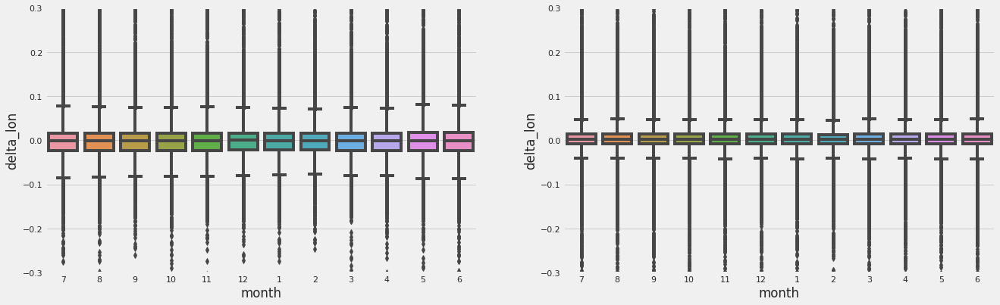

In [33]:
%%time
with plt.style.context("fivethirtyeight"):
    fig, ax = plt.subplots(1,2, figsize=(20,6))
    # delta_lon
    sns.boxplot("month_str", "delta_lon", data=train, ax=ax[0])
    ax[0].set_xlabel("month")
    ax[0].set_ylabel("delta_lon")
    ax[0].set_ylim([-0.3,0.3])
    # delta_lat
    sns.boxplot("month_str", "delta_lat", data=train, ax=ax[1])
    ax[1].set_xlabel("month")
    ax[1].set_ylabel("delta_lon")
    ax[1].set_ylim([-0.3,0.3])

Weekday distribution

In [34]:
%%time
# weekday, delta longtitude & latitude boxplot
train["weekday_str"] = [str(i) for i in train["weekday"]]

CPU times: user 451 ms, sys: 67 ms, total: 518 ms
Wall time: 518 ms


/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



CPU times: user 1.47 s, sys: 2.04 ms, total: 1.48 s
Wall time: 1.47 s


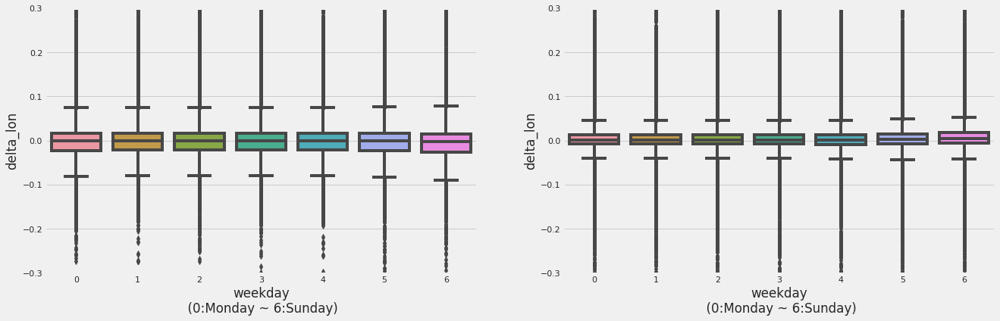

In [35]:
%%time
with plt.style.context("fivethirtyeight"):
    fig, ax = plt.subplots(1,2, figsize=(20,6))
    # delta_lon
    sns.boxplot("weekday_str", "delta_lon", data=train, ax=ax[0])
    ax[0].set_xlabel("weekday\n (0:Monday ~ 6:Sunday)")
    ax[0].set_ylabel("delta_lon")
    ax[0].set_ylim([-0.3,0.3])
    # delta_lat
    sns.boxplot("weekday_str", "delta_lat", data=train, ax=ax[1])
    ax[1].set_xlabel("weekday\n (0:Monday ~ 6:Sunday)")
    ax[1].set_ylabel("delta_lon")
    ax[1].set_ylim([-0.3,0.3])

Call type : A: 1, B: 2, C:3

In [36]:
%%time
# copy dataframe
df_ml = train.copy()

# outlier is dropped
df_ml = df_ml.query("delta_lon <= 0.2 & delta_lon >= -0.2 & delta_lat <= 0.2 & delta_lat >= -0.2")



CPU times: user 727 ms, sys: 398 ms, total: 1.12 s
Wall time: 1.11 s


In [37]:
%%time
# Call type <= 0.2 & delta_lon>=
map_call = {"A":1, "B":2, "C":3}
df_ml["Call_type"] = df_ml["CALL_TYPE"].map(map_call)

# Origin_call
def origin_call_flg(x):
    if x["ORIGIN_CALL"] == None:
        res = 0
    else:
        res = 1
    return res
df_ml["ORIGIN_CALL"] = df_ml.apply(origin_call_flg, axis=1)

# Origin_stand
def origin_stand_flg(x):
    if x["ORIGIN_STAND"] == None:
        res = 0
    else:
        res=1
    return res
df_ml["ORIGIN_STAND"] = df_ml.apply(origin_stand_flg, axis=1)

# Day type
df_ml.drop("DAY_TYPE", axis=1, inplace=True)

# Missing data
def miss_flg(x):
    if x["MISSING_DATA"] == "False":
        res = 0
    else:
        res = 1
    return res
df_ml["MISSING_DATA"] = df_ml.apply(miss_flg, axis=1)

CPU times: user 53.1 s, sys: 7.3 s, total: 1min
Wall time: 1min


In [38]:
%%time
df_ml = df_ml.sample(50000)

CPU times: user 221 ms, sys: 72.9 ms, total: 294 ms
Wall time: 295 ms


In [39]:
%%time
X = df_ml[["Call_type", 'ORIGIN_CALL', 'ORIGIN_STAND', 'MISSING_DATA', 'lon_1st', 'lat_1st', 'delta_lon', 'delta_lat']]

CPU times: user 2.99 ms, sys: 0 ns, total: 2.99 ms
Wall time: 2.89 ms


In [40]:
%%time
y = df_ml[["lon_last","lat_last"]]

CPU times: user 1.83 ms, sys: 0 ns, total: 1.83 ms
Wall time: 1.75 ms


In [41]:
%%time
# copy dataframe
df_ml_t = test.copy()

# Call type <= 0.2 & delta_lon>=
map_call = {"A":1, "B":2, "C":3}
df_ml_t["Call_type"] = df_ml_t["CALL_TYPE"].map(map_call)

# Origin_call
df_ml_t["ORIGIN_CALL"] = df_ml_t.apply(origin_call_flg, axis=1)

# Origin_stand
df_ml_t["ORIGIN_STAND"] = df_ml_t.apply(origin_stand_flg, axis=1)

# Day type
df_ml_t.drop("DAY_TYPE", axis=1, inplace=True)

# Missing data
df_ml_t["MISSING_DATA"] = df_ml_t.apply(miss_flg, axis=1)


CPU times: user 17.9 ms, sys: 26 µs, total: 17.9 ms
Wall time: 17.4 ms


In [42]:
%%time
X_Test = df_ml_t[["Call_type", 'ORIGIN_CALL', 'ORIGIN_STAND', 'MISSING_DATA', 'lon_1st', 'lat_1st', 'delta_lon', 'delta_lat']]

CPU times: user 2.81 ms, sys: 0 ns, total: 2.81 ms
Wall time: 2.83 ms



train test split

In [43]:
%%time
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

CPU times: user 10.6 ms, sys: 0 ns, total: 10.6 ms
Wall time: 10 ms


# 4. Buliding Machine learning Models

 4.1 Random Forest Regressor

In [44]:
%%time
forest = MultiOutputRegressor(RandomForestRegressor(n_estimators=100, random_state=1))

# Fitting
forest = forest.fit(X_train, y_train)
y_train_pred = forest.predict(X_train)
y_test_pred = forest.predict(X_test)

# Make predictions on test data using the model trained on original data

# Performance metrics

print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred)))
print("Mean Square Error on testting Data:{}".format(mean_squared_error(y_test, y_test_pred)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred)))

y_Test_pred = forest.predict(X_Test)

Mean Square Error on training Data:1.771962723130119e-05
Mean Square Error on testting Data:0.004315585672801873
R2 score train:0.9804578637392388
R2 score test:0.3522276344133943
CPU times: user 33.3 s, sys: 223 ms, total: 33.5 s
Wall time: 33.6 s


 4.2 Gradient Boosting Regressor

In [45]:
bosting = MultiOutputRegressor(GradientBoostingRegressor(random_state=0))

# Fitting
bosting = bosting.fit(X_train, y_train)
y_train_pred2 = bosting.predict(X_train)
y_test_pred2 = bosting.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred2)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred2)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred2)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred2)))
y_Test_pred2 = bosting.predict(X_Test)
y_Test_pred2[2]

Mean Square Error on training Data:2.9625560003060303e-06
Mean Square Error on testing Data:0.004150171966343668
R2 score train:0.996967477936437
R2 score test:0.37666718469231336


array([-8.57472054, 41.16646995])

 4.3 Linear Regression for Multioutput Regression

In [46]:
lr = MultiOutputRegressor(LinearRegression(n_jobs=1))

# Fitting
lr = lr.fit(X_train, y_train)
y_train_pred4 = lr.predict(X_train)
y_test_pred4 = lr.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred4)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred4)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred4)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred4)))
y_Test_pred4 = bosting.predict(X_Test)
y_Test_pred4[4]

Mean Square Error on training Data:2.271634628249729e-28
Mean Square Error on testing Data:2.271259722104523e-28
R2 score train:1.0
R2 score test:1.0


array([-8.61862907, 41.14877692])

 4.4 k-Nearest Neighbors for Multioutput Regression

In [47]:
knn = MultiOutputRegressor(KNeighborsRegressor())

# Fitting
knn = knn.fit(X_train, y_train)
y_train_pred5 = knn.predict(X_train)
y_test_pred5 = knn.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred5)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred5)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred5)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred5)))
y_Test_pred5 = bosting.predict(X_Test)
y_Test_pred5[5]

Mean Square Error on training Data:3.95813733794332e-05
Mean Square Error on testing Data:0.004551406058304759
R2 score train:0.9572355947061681
R2 score test:0.29688943551488145


array([-8.62419301, 41.17162226])

 4.5 Decision Tree for Multioutput Regression

In [48]:
dt = MultiOutputRegressor(DecisionTreeRegressor(max_depth=50, random_state=1))

# Fitting
dt = dt.fit(X_train, y_train)
y_train_pred6 = dt.predict(X_train)
y_test_pred6 = dt.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred6)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred6)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred6)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred6)))
y_Test_pred6 = bosting.predict(X_Test)
y_Test_pred6[5]

Mean Square Error on training Data:0.0
Mean Square Error on testing Data:0.0041489967082581
R2 score train:1.0
R2 score test:0.38236601296973577


array([-8.62419301, 41.17162226])

# 5. Submission

In [49]:
%%time
submit_lat = y_Test_pred4.T[1]
submit_lon = y_Test_pred4.T[0]

CPU times: user 0 ns, sys: 16 µs, total: 16 µs
Wall time: 19.6 µs


In [50]:
%%time
submit = pd.DataFrame({"TRIP_ID":test["TRIP_ID"], "LATITUDE":submit_lat, "LONGITUDE":submit_lon})

CPU times: user 1.05 ms, sys: 1e+03 ns, total: 1.05 ms
Wall time: 975 µs


In [51]:
submit.to_csv('submission.csv', index=False)
sub = pd.read_csv("./submission.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.146759,-8.585153
1,T2,41.163473,-8.603158
2,T3,41.166470,-8.574721
3,T4,41.141275,-8.613841
4,T5,41.148777,-8.618629
